# 20_分析分子动力学模拟

## 目的

- 我们将介绍分子动力学（MD）模拟的分析方法。引入的方法包括动画可视化、结构对齐、RMSD计算以及选定的原子距离和氢键分析。

- 请注意，我们将使用**19**在与抑制剂[03P]（https://www.rcsb.org/ligand/03P）
- 绑定的EGFR激酶（[PDB：3POZ]（https://www.rcsb.org/structure/3poz））
- 该模拟使用了Gromacs模拟器，并在100个时间步上生成的模拟结果（1ns，100帧）。

### *理论*中的内容

- MD模拟

- 在药物发现过程中的应用

- 柔性与静态结构

- 分析MD模拟

- 可视化

- RMSD

- 氢键分析

### 实战

- 加载并可视化系统

- 对齐

- 蛋白质和配体的RMSD

- 随着时间的推移，RMSD

- 帧之间的RMSD

- 互动分析

- 原子距离

- 氢键分析

## 理论

### MD模拟

### 药物发现过程中的应用

在过去的几十年里，人们对基于结构的药物设计的兴趣一直在增长。采用GPU的更快算法和架构的开发为分子动力学（MD）模拟成为药物发现过程中常规应用的计算工具铺平了道路。MD模拟的主要资产之一是更准确地估计药物靶点识别和结合过程。如今，各种计算方法建立在MD模拟之上，并为设计、选择和优化新候选药物过程中遇到的许多挑战提供工具（[_J Med Chem._ 2016, **59(9)**, 4035-61](https://doi.org/10.1021/acs.jmedchem.5b01684)）。

有关如何对蛋白质-配体复合物进行MD模拟的更多详细信息，另请参阅**19**。

### 柔性与静态结构

蛋白质-配体复合物的静态模型，如X射线结构，允许评估铅候选物的结合模式，可用于系统地建议合成新型类似物，以提高亲和力和力化学特性。然而，静态结构无法解释药物-靶点结合的所有现象，因为配体、靶点和周围环境（例如溶剂和/或膜）之间观察到的众多相互作用不能仅通过系统当前平衡状态的焓来描述。

相比之下，基于力场的MD模拟解释了蛋白质和配体的结构灵活性以及药物结合的熆贡献。因此，它们允许更准确地估计结合亲和力、检测构象变化、分析时间相互作用几何形状等（[_J Med Chem._ 2016, **59(9)**, 4035-61](https://doi.org/10.1021/acs.jmedchem.5b01684)）。

### 分析MD模拟

由于本演讲旨在介绍MD模拟分析，我们将执行基本分析步骤，以初步了解该领域。

标准MD模拟的结果通常保存在两种文件类型中。

* *系统的拓扑结构*，它告知了模拟系统，即通过键连接的一组定义的原子。

* *原子的位置*随着时间的推移

将两种文件类型加载到分子可视化工具中，可用于创建模拟系统的实例。在下面使用的MD分析库（`MDAnalysis`）中，这个系统被称为*宇宙*。

#### 可视化

包含MD模拟的宇宙可以作为一个整体可视化，通常包括动画。它们允许用肉眼观察构象变化、波动和结合/解结合过程。

（https://github.com/arose/nglview/blob/master/examples/mdanalysis.md）。

#### RMSD

跟踪构象变化的一种更充分的方法是计算均方根偏差（RMSD，[维基百科]（https://en.wikipedia.org/wiki/Root-mean-square_deviation_of_atomic_positions））。该方法测量原子位置与原子位置参考集的偏差。RMSD图可用于描述整个蛋白质或其结构域在折叠或药物结合过程中的相对运动。此外，RMSD计算可用于将计算的对接配置与已知的（即晶体学）绑定姿势进行比较，以验证对接协议**（！注意：需要为对接对话添加适当的引用！）**。

对于两个通常叠加的原子坐标v和w与n个元素的集合，RMSD的定义如下：

$$RMSD(v,w) = \sqrt{ \frac{1}{n} \sum_{i=1}^n \|v_i - w_i\|² }$$

为了在模拟中区分蛋白质的灵活和稳定部分，可以使用均方根波动（RMSF）计算，这允许从其平均结构中可视化残差的波动。

#### 氢键分析

氢键等非共价相互作用是配体-蛋白质复合物形成的关键因素（[_PLoS One._（2010），**5（8）**，e12029]（https://doi.org/10.1371%2Fjournal.pone.0012029），[_J.医学。Chem._ 2010, **53(14)**, 5061-84](https://doi.org/10.1021/jm100112j)).它们的吸引力电位来自部分带正电荷的氢气指向部分带负电荷的氢键受体原子，例如氧或氮气。氢键的分析可以为配体-蛋白复合物的稳定性提供有价值的见解，并指导铅分子的修饰以改善其活性。氢键的强度可以通过分析供体、氢原子和受体原子之间的角度和距离来估计。小距离和接近180°的角度表示强键，而更大的距离和更小的角度表示较弱的键。



对于计算分析，几何阈值通常用于确定哪些相互作用可以被视为氢键：受体和氢之间的距离必须小于或等于距离阈值，供体、氢和受体之间的角度需要大于或等于角度阈值。例如，我们将用于分析的Python软件包__[MDAnalysis]（https://docs.mdanalysis.org/2.0.0/documentation_pages/analysis/hydrogenbonds.html）__将默认最大距离设置为3 Å，最小角度设置为120°。

## 实战

在下面，我们将加载MD模拟，并随着时间的推移分析配体和蛋白质。

我们分析的MD模拟是在**19**中进行的模拟，该模拟了表皮生长因子受体（EGFR）激酶（[PDB:3POZ]（https://www.rcsb.org/structure/3poz））
与抑制剂[03P]（https://www.rcsb.org/ligand/03P）
复合物。系统总共模拟了100个ps，并保存了100个快照（帧）（为了方便起见，文件在“data”文件夹中可用）。

我们将可视化模拟，然后进行RMSD计算和（氢）键分析。

In [125]:
from pathlib import Path

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import nglview as nv
import MDAnalysis as mda
from MDAnalysis.analysis import rms, diffusionmap, align
from MDAnalysis.analysis.distances import dist
from MDAnalysis.analysis.hydrogenbonds.hbond_analysis import HydrogenBondAnalysis as HBA

In [126]:
HERE = Path(_dh[-1])
DATA = HERE / "data"

### 加载并可视化系统

作为第一步，我们加载拓扑（`.pdb`）和轨迹（`.xtc`）文件，以创建代表模拟系统的MDAnalysis“宇宙”。

宇宙可以很容易地被整体可视化，包括轨迹的动画。

[NGL Viewer]（http://nglviewer.org/）提供预构建功能，以可视化在MD分析等常见库中加载的模拟。

In [128]:
md_universe = mda.Universe(str(DATA / "topology.pdb"), str(DATA / "trajectory.xtc"))
view = nv.show_mdanalysis(md_universe)
view

NGLWidget(max_frame=99)

In [129]:
view.render_image(trim=True, factor=2, transparent=True);

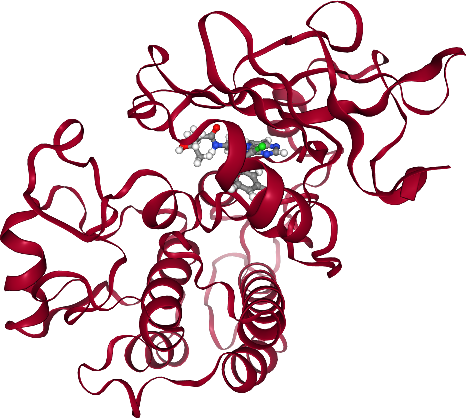

In [130]:
view._display_image()

### 对齐

虽然在这种相当短的轨迹的可视化中几乎没有注意到，但根据使用的模拟包/设置，蛋白质可以在模拟过程中旋转和转换。这可能会使对轨迹的目视检查复杂化，通常需要作为分析前一步的对齐。调整轨迹的常见选择是蛋白质。因此，蛋白质不会偏离中心，也不会旋转，允许观察不结合事件或构象变化。

[MDAnalysis]（https://docs.mdanalysis.org/stable/index.html）
框架允许使用字符串在原子选择上轻松对齐，并内置了简单的选择关键字，例如“蛋白质”，它选择通常属于蛋白质的所有残基。

在下一步中，我们将把轨迹（移动）的结构对齐到参考结构上。参考结构中当前活跃的框架将用于对齐。

In [131]:
# 设置轨迹指针到第一帧作为参考
md_universe.trajectory[0]

# in_memory=True需要实际修改加载轨迹
# 如果轨迹太大，无法记住，可以写出对齐的轨迹，并将其重新加载到一个新的宇宙中
alignment = align.AlignTraj(
    mobile=md_universe, reference=md_universe, select="protein", in_memory=True
)
alignment.run()

In [132]:
view = nv.show_mdanalysis(md_universe)
view

NGLWidget(max_frame=99)

In [133]:
view.render_image(trim=True, factor=2, transparent=True);

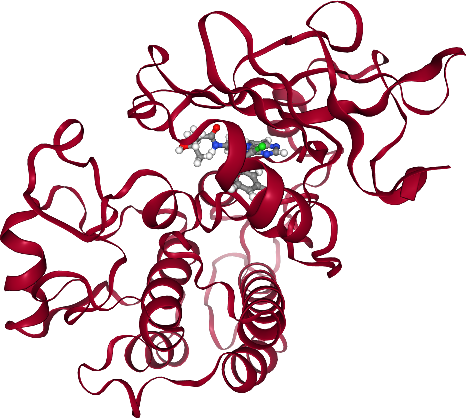

In [134]:
view._display_image()

### 蛋白质和配体的RMSD

蛋白质和配体在动画中可以清楚地区分。然而，很难估计配体或蛋白质是否真的显著改变了它们的位置/形成。因此，我们将使用一种更充分的方法，即RMSD的计算来评估相对运动。因此，我们将专注于系统的不同部分（骨干、蛋白质和配体）。配体最好根据其独特的残基名称来选择。在这种情况下，我们知道它是抑制剂`03P`，但我们也可以通过检查拓扑文件或将光标悬停在上述动画中的配体原子上找到名称。

In [135]:
ligand_name = "03P"

#### 随着时间的推移，RMSD

为了绘制RMSD，我们编写了一个函数，该函数对宇宙中选定的原子群进行RMSD计算，并返回一个“数据框架”。

In [136]:
def rmsd_for_atomgroups(universe, selection1, selection2=None):
    """Calulate the RMSD for selected atom groups.

    Parameters
    ----------
    universe: MDAnalysis.core.universe.Universe
        MDAnalysis universe.
    selection1: str
        Selection string for main atom group, also used during alignment.
    selection2: list of str, optional
        Selection strings for additional atom groups.

    Returns
    -------
    rmsd_df: pandas.core.frame.DataFrame
        DataFrame containing RMSD of the selected atom groups over time.
    """

    universe.trajectory[0]
    ref = universe
    rmsd_analysis = rms.RMSD(universe, ref, select=selection1, groupselections=selection2)
    rmsd_analysis.run()
    columns = [selection1, *selection2] if selection2 else [selection1]
    rmsd_df = pd.DataFrame(np.round(rmsd_analysis.results.rmsd[:, 2:], 2), columns=columns)
    rmsd_df.index.name = "frame"
    return rmsd_df

运行该函数，在模拟期间计算所选分子的RMSD：

*全蛋白质

*蛋白质骨架原子

*配体

在计算过程中，分子将沿着蛋白质的骨架叠加在第一帧（参考）上。

In [137]:
rmsd = rmsd_for_atomgroups(md_universe, "backbone", ["protein", f"resname {ligand_name}"])
rmsd.head()

,backbone,protein,resname 03P
frame,,,
0,0.00,0.00,0.00
1,0.83,1.12,1.72
2,0.96,1.28,1.62
3,0.99,1.36,1.57
4,1.03,1.44,1.51


Then, we plot the results.

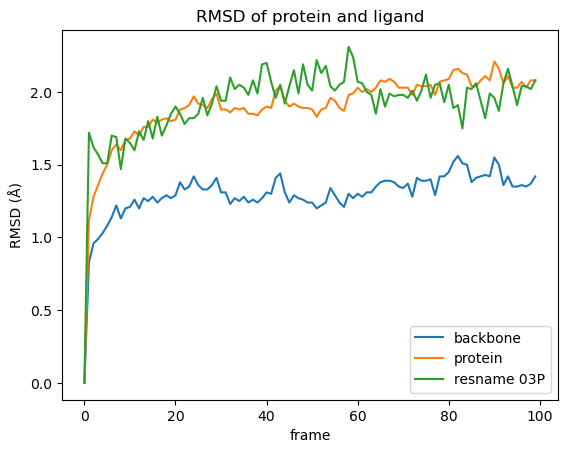

In [138]:
rmsd.plot(title="RMSD of protein and ligand")
plt.ylabel("RMSD (Å)");

我们可以在情节中看到什么：

*在模拟过程中，脊柱只有轻微的构象变化，这并不奇怪，因为蛋白质与脊柱叠加。

*仅与蛋白质主干相比，在RMSD计算中包括蛋白质侧链会导致更多的运动。

*在我们的模拟中，配体的运动与蛋白质侧链的范围相同。然而，情况并非总是如此，因为配体可以更自由地移动，此外，任何构象变化外，还可能涉及定向运动。如果配体的RMSD值特别高，情况就可能如此。

#### RMSD between frames

之前的图显示了给定时间与初始状态的距离。

现在，我们计算所有帧（成对）之间的差异，并在热图中可视化。

In [139]:
def RMSD_dist_frames(universe, selection):
    """Calculate the RMSD between all frames in a matrix.

    Parameters
    ----------
    universe: MDAnalysis.core.universe.Universe
        MDAnalysis universe.
    selection: str
        Selection string for the atomgroup to be investigated, also used during alignment.

    Returns
    -------
    array: np.ndarray
        Numpy array of RMSD values.
    """
    pairwise_rmsd = diffusionmap.DistanceMatrix(universe, select=selection)
    pairwise_rmsd.run()
    return pairwise_rmsd.results.dist_matrix

首先，我们使用上述函数计算蛋白质和配体的距离矩阵。

然后，我们将它们并排绘制成热图。

In [140]:
dist_matrix_protein = RMSD_dist_frames(md_universe, "protein")
dist_matrix_ligand = RMSD_dist_frames(md_universe, f"resname {ligand_name}")

为了实现可比的热图，重要的是将两个图中的最小值和最大值设置为相同的值。

我们将最小值设置为0，并从距离矩阵中推导出上限。

In [141]:
# get maximal distance between all frames
max_dist = max(np.amax(dist_matrix_ligand), np.amax(dist_matrix_protein))

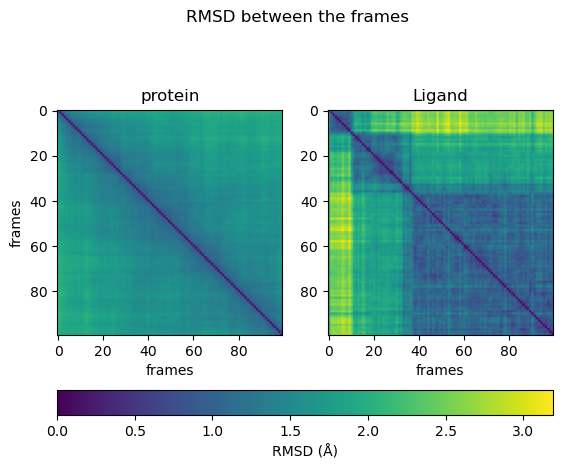

In [142]:
fig, ax = plt.subplots(1, 2)
fig.suptitle("RMSD between the frames")

# protein image
img1 = ax[0].imshow(dist_matrix_protein, cmap="viridis", vmin=0, vmax=max_dist)
ax[0].title.set_text("protein")
ax[0].set_xlabel("frames")
ax[0].set_ylabel("frames")

# ligand image
img2 = ax[1].imshow(dist_matrix_ligand, cmap="viridis", vmin=0, vmax=max_dist)
ax[1].title.set_text("Ligand")
ax[1].set_xlabel("frames")

fig.colorbar(img1, ax=ax, orientation="horizontal", fraction=0.1, label="RMSD (Å)");

从热图中，我们可以得出结论，蛋白质在状态之间持续均匀地移动。配体在不同的状态之间*跳*。有时它可以反复达到类似的构象。

#### 交互作用分析
现在，我们来看看蛋白质和配体之间的相互作用。让我们再次对系统进行可视化，包括绑定口袋中的一些更多细节。配体周围5 Å半径范围内的所有残基都显示为可见的原子和键。

In [143]:
# select pocket residues
pocket_resids = set(
    md_universe.select_atoms(f"(around 5 resname {ligand_name}) and protein").resids
)
view2 = nv.show_mdanalysis(md_universe)
view2.add_representation(
    "licorice", selection=f"protein and ({' '.join([str(x) for x in pocket_resids])})"
)
view2.center(selection="ligand")
view2

NGLWidget(max_frame=99)

In [144]:
view2.render_image(trim=True, factor=2, transparent=True);

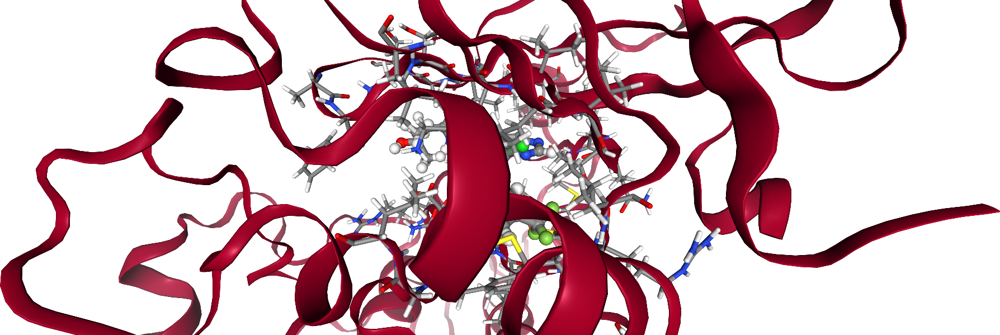

In [146]:
view2._display_image()

#### Atomic distances

我们现在放大并寻找手头项目可能感兴趣的互动。在这个例子中，我们想看看与配体的芳香环密切接触的甲硫氨酸793的骨基氮。理论上，只要每个原子群的原子数量相同，就可以计算出原子群的距离，但我们想看看单个原子之间的距离。

单原子选择可以明确地通过该残基内的残基ID和原子名称的组合来明确地进行。残留名称不是唯一的，因此在这里不使用。

在上述详细视图中，当将鼠标悬停在选定的原子上时，可以访问原子名称及其相应的残留ID。

In [151]:
protein_residue_id = "793"
protein_atom_name = "N"
ligand_id = "1"
ligand_atom_name = "N4"

我们选择用于分析的原子群，在本例中，每个原子群将包含一个原子。

In [163]:
atomgroup_protein = md_universe.select_atoms(
    f"resid {protein_residue_id} and name {protein_atom_name}"
)
atomgroup_ligand = md_universe.select_atoms(f"resname {ligand_name} and name {ligand_atom_name}")

现在，我们可以计算我们宇宙当前设定的框架中原子之间的距离（使用来自`MDAnalysis`的`dist`函数）。

该函数返回一个数组：前两个元素是残差ID，但我们只对第三个条目，即距离感兴趣。

In [164]:


# atomgroup_ligand = md_universe.select_atoms(f"resname {ligand_name} and name {ligand_atom_name}")
# if len(atomgroup_ligand) > 0:
#     atomgroup_ligand = atomgroup_ligand.atoms[0]
# else:
#     print("No atoms found for the given selection")



# for ts in md_universe.trajectory:
#     atoms = md_universe.select_atoms(f"resname {ligand_name} and name {ligand_atom_name}")
#     if atoms:
#         print(f"Found atoms in frame {ts.frame}")


distance = dist(atomgroup_protein, atomgroup_ligand)
print(
    f"The distance between residues {protein_residue_id} and {ligand_id} is {distance[2][0]:.2f} Å"
)


The distance between residues 793 and 1 is 3.52 Å


在3.5Å时，距离足够近，可以在介导配体的结合方面发挥作用，值得仔细观察。我们刚刚测量的甲硫氨酸793的配体和骨干氮之间的相互作用实际上是许多激酶中与铰链区域的众所周知的键。

为了收集更多信息，我们想看看距离随着时间的推移的发展。我们可以迭代帧，并计算每个帧的距离。宇宙的轨迹属性作为一个指针工作，只包含有关一个时间步骤的信息。指针沿着轨迹文件移动，任何选择都会在途中自动更新。

In [165]:
distances = []
for _ in md_universe.trajectory:
    distance = dist(atomgroup_protein, atomgroup_ligand)
    distances.append(distance[2][0])

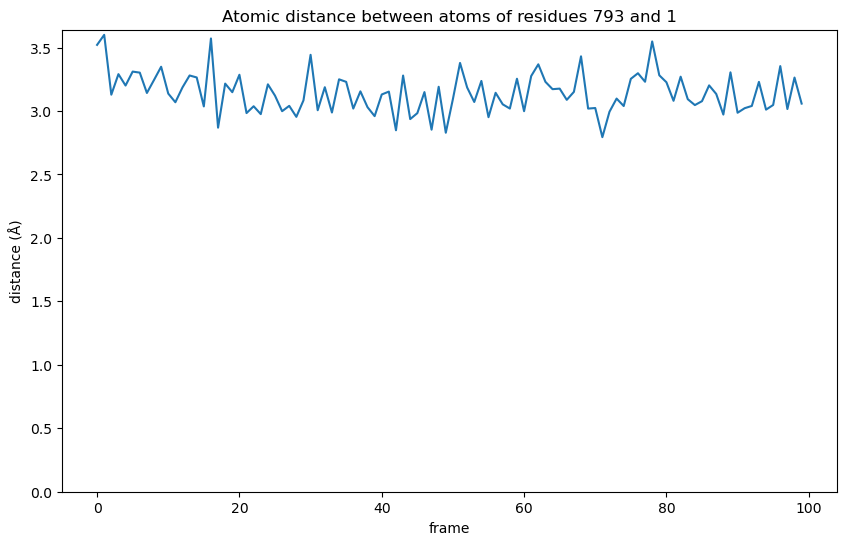

In [166]:
plt.figure(figsize=(10, 6))
plt.plot(distances)
plt.gca().set_ylim(bottom=0)
plt.ylabel("distance (Å)")
plt.xlabel("frame")
plt.title(f"Atomic distance between atoms of residues {protein_residue_id} and {ligand_id}")
plt.show()

从图形中我们看到，在相互作用过程中，距离比最初在第一帧中观察到的3.52 φ变短。这意味着，这种相互作用起初变得更强，尽管存在波动，但在较长时期内保持相对稳定。

#### 氢键分析
当它发生时，与我们所分析的铰链区域的相互作用形成了氢键。甲硫氨酸主链上的氮作为给体，配体芳环上的氮作为受体。
我们回到可视化，以获得形成该键的氢的唯一名称。然后，我们可以利用[ MDAnalysis ] ( https://docs.mdanalysis.org/1.0.0/documentation_pages/analysis/hydrogenbonds.html) )的氢键分析能力来确定氢键的特征距离和角度。氢键分析涵盖了所有框架，无需人工迭代，绘图方便。

In [167]:
hydrogen_name = "H"

In [168]:
def run_hydrogenbond_analysis(
    universe,
    donor_resid,
    donor_atom,
    hydrogen_atom,
    acceptor_resid,
    acceptor_atom,
    h_cutoff=1.2,
    a_cutoff=3.0,
    angle_cutoff=120,
):
    """
    Perform an hydrogen bond analysis between selcted atom groups.
    Return the data as readable, formatted data frame.

    Parameters
    ----------
    universe: MDAnalysis.core.universe.Universe
        MDAnalysis universe.
    donor_resid: str
        Residue Id of residue containing donor atom in MDAnalysis universe.
    donor_atom: str
        Name of the donor atom in the MDAnalysis universe.
    hydrogen_atom: str
        Name of involved hydrogen atom in the MDAnalysis universe.
    acceptor_resid: str
        Residue Id of residue containing acceptor atom in the MDAnalysis universe.
    acceptor_atom: str
        Name of the acceptor atom in the MDAnalysis universe.
    h_cutoff: float, optional
        Distance cutoff used for finding donor-hydrogen pairs.
    a_cutoff: float, optional
        Donor-acceptor distance cutoff for hydrogen bonds.
    angle_cutoff: int, optional
        D-H-A angle cutoff for hydrogen bonds.

    Returns
    -------
    bond : pandas.core.frame.DataFrame
        DataFrame containing hydrogen bond information over time.
    """

    # set up and run the hydrogen bond analysis (HBA)
    hbonds = HBA(
        universe=universe,
        donors_sel="resid " + donor_resid + " and name " + donor_atom,
        hydrogens_sel="resid " + donor_resid + " and name " + hydrogen_atom,
        acceptors_sel="resid " + acceptor_resid + " and name " + acceptor_atom,
        d_h_cutoff=h_cutoff,
        d_a_cutoff=a_cutoff,
        d_h_a_angle_cutoff=angle_cutoff,
    )
    hbonds.run()
    # extract bond data
    bond = pd.DataFrame(np.round(hbonds.results.hbonds, 2))
    # name columns (according to MDAnalysis function description)
    bond.columns = [
        "frame",
        "donor_index",
        "hydrogen_index",
        "acceptor_index",
        "distance",
        "angle",
    ]
    # set frame as the index
    bond["frame"] = bond["frame"].astype(int)
    bond.set_index("frame", inplace=True, drop=True)
    return bond

我们使用函数运行氢键分析，该函数返回一个数据帧。

In [170]:
bond = run_hydrogenbond_analysis(
    md_universe, protein_residue_id, protein_atom_name, hydrogen_name, ligand_id, ligand_atom_name
)
bond.head()

/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/analysis/hydrogenbonds/hbond_analysis.py:722: UserWarning: No hydrogen bonds were found given d-a cutoff of 3.0 between Donor, resid 793 and name N, and Acceptor, resid 1 and name N4.
  warnings.warn(
/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/analysis/hydrogenbonds/hbond_analysis.py:751: UserWarning: No hydrogen bonds were found given angle of 120 between Donor, resid 793 and name N, and Acceptor, resid 1 and name N4.
  warnings.warn(


,donor_index,hydrogen_index,acceptor_index,distance,angle
frame,,,,,
17,1483.0,1484.0,5529.0,2.87,144.73
21,1483.0,1484.0,5529.0,2.98,162.87
23,1483.0,1484.0,5529.0,2.98,173.41
26,1483.0,1484.0,5529.0,3.00,175.31
28,1483.0,1484.0,5529.0,2.95,163.73


- 在表格中，我们可以看到，在模拟过程中，只在某些帧中识别出了该键。
- 使用的模块搜索具有严格预定义约束的氢键。使用默认设置，只有当给体和受体之间的距离大于3 Å，给体和氢之间的距离小于1.2 Å，并且夹角大于120 ° (见图1)时，才能检测到- 键。对于不满足约束条件的框架，不计入黏结。
- 为了在整个模拟过程中跟踪该键，我们可以改变这些阈值来检测处于"较弱"状态的键。
- 由上表可知，角度似乎足够高，而距离则更接近3 Å截止距离。因此，我们再次尝试对供体和受体的距离截断值为5 ?的情况进行分析

In [171]:
bond = run_hydrogenbond_analysis(
    md_universe,
    protein_residue_id,
    protein_atom_name,
    hydrogen_name,
    ligand_id,
    ligand_atom_name,
    a_cutoff=5.0,
)
bond.head()

,donor_index,hydrogen_index,acceptor_index,distance,angle
frame,,,,,
0,1483.0,1484.0,5529.0,3.52,166.39
1,1483.0,1484.0,5529.0,3.60,145.63
2,1483.0,1484.0,5529.0,3.13,173.95
3,1483.0,1484.0,5529.0,3.29,151.99
4,1483.0,1484.0,5529.0,3.20,170.21


Now, we plot the bond.

In [172]:
def plot_hydrogen_bond_over_time(bond):
    """
    Plot the distance and degree of a chosen hydrogen bond over time.
    Peaks in angle and dips in distance represent moments of strong binding.

    Parameters
    ----------
    bond: pandas.core.frame.DataFrame
        Hydrogen bond analysis data frame with named columns.
    """

    donor_index = bond.iloc[0].donor_index
    acceptor_index = bond.iloc[0].acceptor_index

    # add values for missing frames for gapless plotting
    bond = bond.reindex(np.arange(0, 99))

    # plot the data
    fig = plt.figure(figsize=(10, 6))
    distance = bond.distance.plot(
        title=f"H-Bond between donor {donor_index} and acceptor {acceptor_index}",
        style="o-",
        x="frame",
    )
    distance.set_ylabel("distance (Å)")
    distance.set_xlabel("frame")
    distance.set_ylim(bottom=0)
    angle = bond.angle.plot(secondary_y=True, style="o-", x="frame")
    angle.set_ylabel("angle (°)")
    angle.set_xlabel("frame")
    angle.set_ylim(bottom=0)
    fig.legend(loc="lower right", bbox_to_anchor=(1, 0), bbox_transform=distance.transAxes)
    plt.show()

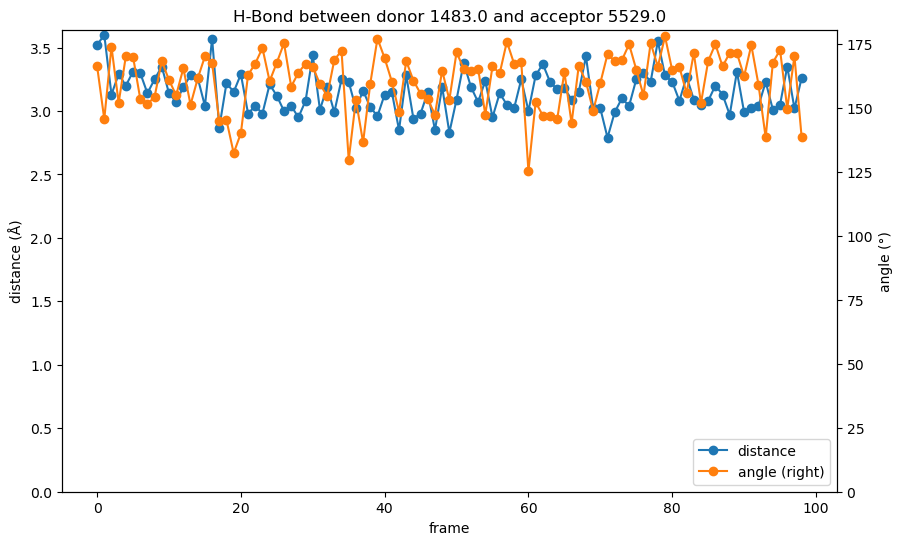

In [173]:
plot_hydrogen_bond_over_time(bond)

虽然氢键分析中的距离值与上面纯距离图中我们看到的相同，但与键角的结合提升了信息。如前所述，在整个模拟过程中，氢键长度的距离都在上端，但键角始终保持在180 °附近，并稳定了键。从分析中我们可以假设激酶铰链区骨架甲硫氨酸之间的相互作用确实是配体结合的关键因素。

In [174]:
view_strong = nv.show_mdanalysis(md_universe)
view_strong.add_representation("ball+stick", selection=f"protein and {protein_residue_id}")
view_strong.center(selection="ligand")
view_strong.frame = 71
view_strong

NGLWidget(frame=71, max_frame=99)

In [175]:
view_bad = nv.show_mdanalysis(md_universe)
view_bad.add_representation("ball+stick", selection=f"protein and {protein_residue_id}")
view_bad.center(selection="ligand")
view_bad.frame = 1
view_bad

NGLWidget(frame=1, max_frame=99)

## 讨论
分析MD模拟的方法有很多种。在这篇演讲中，我们只探索了一小部分可用的方法来给用户提供最初的见解。有些方法比较直接，比如系统的可视化或者RMSD的计算，而有些方法则需要更加精细。特别是氢键分析还依赖于人工输入和调整。但是，随着该领域的进一步发展，我们可以期望框架变得越来越精致。
在分析过程中使用的MD模拟实际上太短，无法提供关于蛋白质或配体的结合和非结合事件甚至构象变化的有统计意义的数据。为了充分利用MD模拟的能力，需要访问高性能集群。